### Problem 1. Feed Forward

1. Draw a network

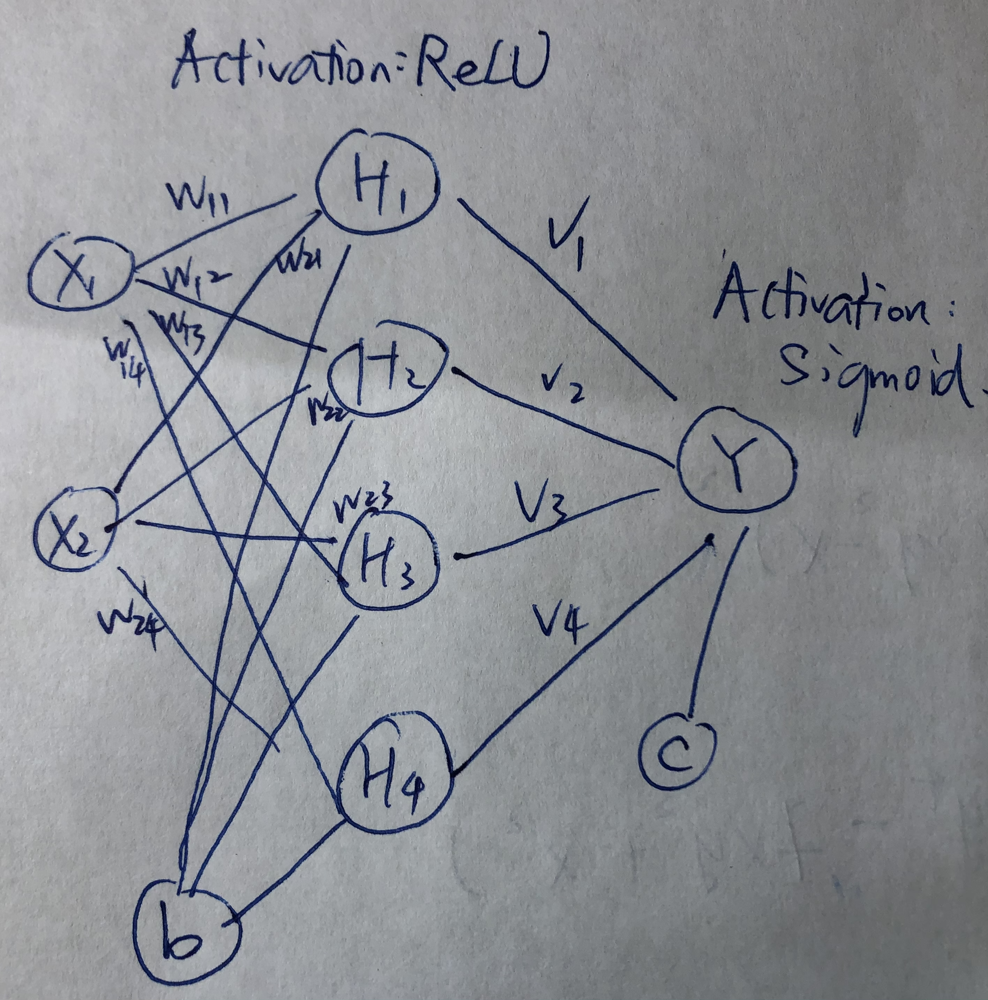

In [1]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(filename = "network_pic.png", width=600, height=600)

2. Write an equition for the output

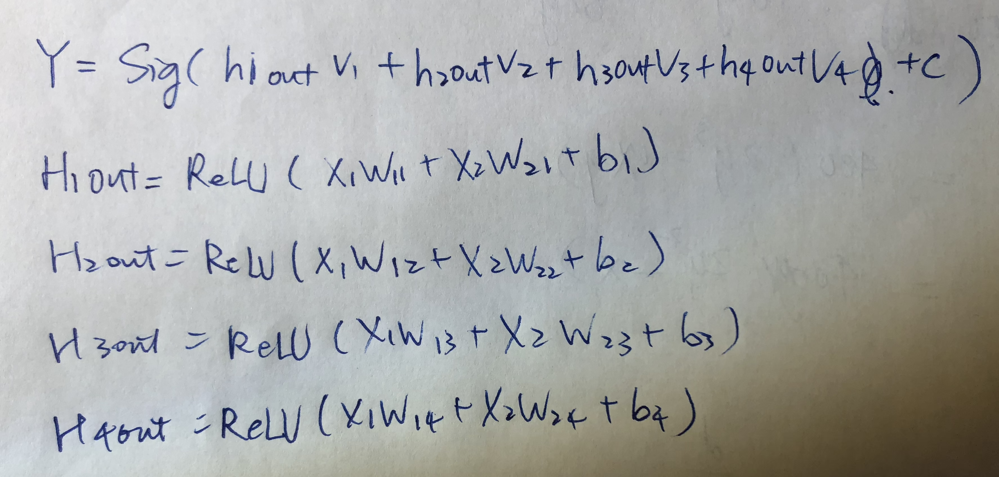

In [2]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(filename = "equition_pic.png", width=600, height=600)

3. forward pass function

In [2]:
import numpy as np

def relu(z):
  return np.where(z>0, z, 0)

def ff_nn_relu(X, W, b):
  return relu(np.dot(X, W) + b)

4. Output probability distribution

In [3]:
def sigmoid(z):
  return 1/(1+np.exp(-z))

def ff_nn_output(hidden_output, V, c):
  return sigmoid(np.dot(hidden_output, V) + c)

X = np.asarray([[1,-1], [0, -1], [0, 1]])
W = np.asarray([[1, -1, 0, 1], [0, 0, 0.5, 1]])
b = np.asarray([0, 0, 1, 0])
V = np.asarray([1, 0, -1, 1])
c = np.asarray([1])

relu_output = ff_nn_relu(X, W, b)
probs = ff_nn_output(relu_output, V, c)

In [4]:
probs

array([0.81757448, 0.62245933, 0.62245933])

### Problem 2. Gradient Descent

1. Partial derivatives

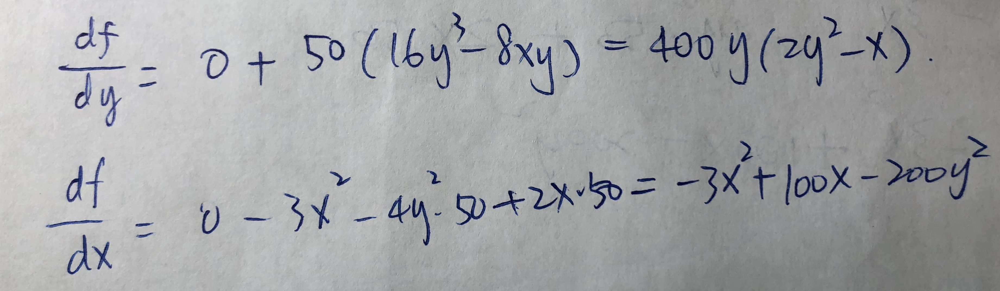

In [3]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(filename = "partial_deriv_pic.png", width=600, height=600)

2. Visualization

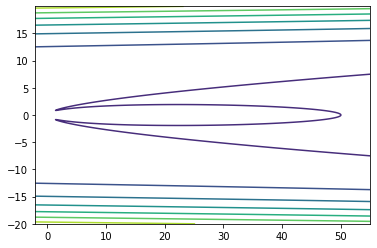

In [17]:
import matplotlib.pyplot as plt
delta = 0.025
x = np.arange(-2.0, 55.0, delta)
y = np.arange(-20.0, 20.0, delta)
X, Y = np.meshgrid(x, y)
Z = (3 - X**3) + 50 * (2 * Y**2 - x)**2 
fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)

3. Gradient Descent

In [19]:
def grad_f(vector):
  x, y = vector
  df_dx = (2/125)*x 
  df_dy = (2/25)*y
  return np.array([df_dx, df_dy])

def grad_descent(starting_point=None, iterations=10, learning_rate=12):
  if starting_point is None:
      starting_point = np.random.uniform(-10,10, size=2)
  print("Starting point:", starting_point)
  trajectory = []
  prev_step = starting_point
  for it in range(iterations):
      this_step = prev_step - learning_rate * grad_f(prev_step) 
      trajectory.append(this_step)
      prev_step = this_step
  return np.array(trajectory)

Starting point: [ 5.42641287 -9.58496101]
Ending point: [ 1.06728572 -0.00156875]


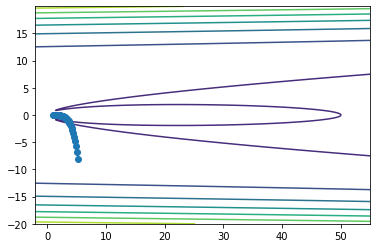

In [32]:
## learning rate = 2
np.random.seed(10)
traj = grad_descent(iterations=50, learning_rate=2)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

In [30]:
traj[-1]

array([ 7.4843806e-038, -1.9762626e-323])

Starting point: [ 5.42641287 -9.58496101]
Ending point: [ 4.62289787 -4.27902942]


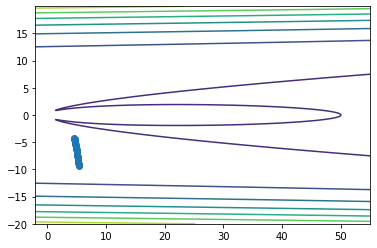

In [33]:
## learning rate = 0.2
np.random.seed(10)
traj = grad_descent(iterations=50, learning_rate=0.2)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

Starting point: [ 5.42641287 -9.58496101]
Ending point: [ 1.98749146e-01 -4.04609417e-08]


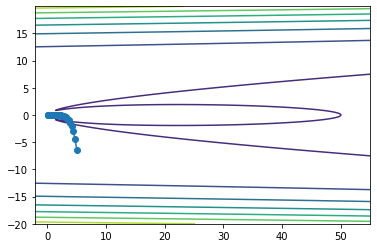

In [34]:
## learning rate = 4
np.random.seed(10)
traj = grad_descent(iterations=50, learning_rate=4)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

Starting point: [ 5.42641287 -9.58496101]
Ending point: [ 2.29064859e-08 -7.74734453e-11]


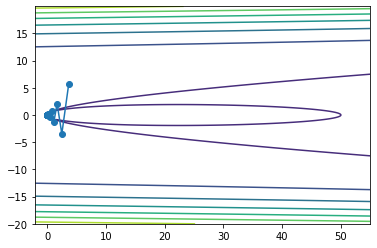

In [35]:
## learning rate = 20
np.random.seed(10)
traj = grad_descent(iterations=50, learning_rate=20)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

4. Gradient descent with momentum

In [38]:
def grad_descent_with_momentum(starting_point=None, iterations=10, alpha=.9, epsilon=10):
    if starting_point is None:
        starting_point = np.random.uniform(-10,10, size=2)
    print("Starting point:", starting_point)
    trajectory = []
    prev_step = starting_point
    prev_velocity = grad_f(starting_point)
    for it in range(iterations):
        this_velocity = alpha * prev_velocity + epsilon * grad_f(prev_step)
        this_step = prev_step - this_velocity
        trajectory.append(this_step)
        prev_step = this_step
        prev_velocity = this_velocity
    return np.array(trajectory)

Starting point: [ 5.42641287 -9.58496101]
Ending point: [4.64930754e-15 1.14819446e-14]


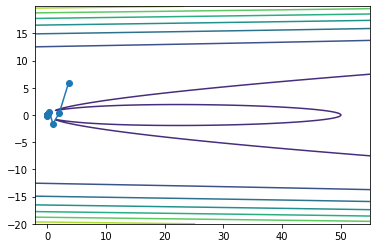

In [41]:
## 0.25 Momentum
np.random.seed(10)
traj = grad_descent_with_momentum(iterations=50, epsilon=20, alpha=0.25)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

Starting point: [ 5.42641287 -9.58496101]
Ending point: [-1.25626252e-07 -1.71083916e-07]


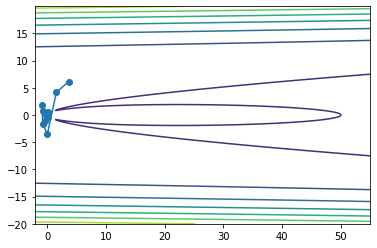

In [42]:
## Super high momentum
np.random.seed(10)
traj = grad_descent_with_momentum(iterations=50, epsilon=20, alpha=0.5)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

Starting point: [ 5.42641287 -9.58496101]
Ending point: [ 1.12131386e-08 -5.97296737e-13]


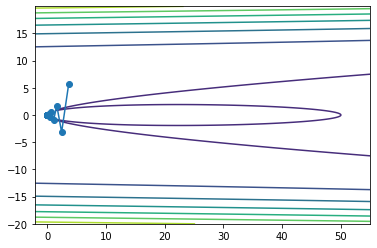

In [43]:
## Super low momentum
np.random.seed(10)
traj = grad_descent_with_momentum(iterations=50, epsilon=20, alpha=0.02)

fig, ax = plt.subplots()
CS = ax.contour(X, Y, Z)
x= traj[:,0]
y= traj[:,1]
plt.plot(x,y,'-o')
print("Ending point:", traj[-1])

### Problem 3. Back Prop

1. Expression of loss w.r.t. each parameter

In [ ]:
a = np.dot(x,W)+b
h = relu(a)
y_a = np.dot(h,v)+c
y_hat = sigmoid(y_a)

dL_dc = (y/y_hat - (1-y)/(1-y_hat)).dot(y_hat*(1-y_hat) )
dL_dv = (y/y_hat - (1-y)/(1-y_hat)) * y_hat*(1-y_hat)).T.dot(h)
dL_db = (y/y_hat - (1-y)/(1-y_hat)) * y_hat*(1-y_hat)).T.dot(np.where(a>0, 1, 0))*v
dL_dw = x.T.dot(np.expand_dims(((y/y_hat - (1-y)/(1-y_hat)) * y_hat*(1-y_hat)),1).dot(np.expand_dims(v,1).T))

2. gradient of loss at each location

In [60]:
def binary_xent_residual(y, y_hat):
  return (y/y_hat - (1-y)/(1-y_hat))

def relu_derivative(x):
    return np.where(x>0, 1, 0)

def grad_f(x, y, W, b, v, c):
  # forward pass
  a = np.dot(x,W)+b
  h = relu(a)
  y_a = np.dot(h,v)+c
  y_hat = sigmoid(y_a)
  
  # backward pass
  dL_dc = binary_xent_residual(y, y_hat).dot( y_hat*(1-y_hat) )
  dL_dv = (binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(h)
  dL_db = (binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(relu_derivative(a))*v
  dL_dw = x.T.dot(np.expand_dims((binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)),1).dot(np.expand_dims(v,1).T))
     
  return [dL_dw, dL_db, dL_dv, dL_dc]

3. Generate XOR dataset

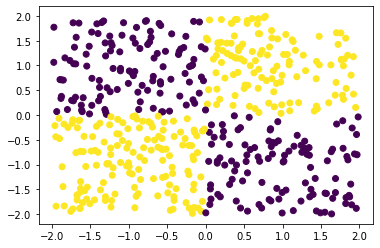

In [61]:
x = np.random.uniform(low=-2,high=2,size=1000).reshape((500,2))
y = np.zeros(500)
y[np.logical_and(x[:,0]>0 , x[:,1]>0)]=1
y[np.logical_and(x[:,0]<0 , x[:,1]<0)]=1
plt.scatter(x[:,0],x[:,1],c=y)

4. XOR data fitting with gradient descent

In [115]:
class MLP:
  """
  Multilayer Perceptron (ANN with single hidden layer) 
  This output layer of this network is specified for binary classification
  and crossentropy loss. 
  """
  def __init__(self, n_input, n_hidden):
    self.n_input = n_input
    self.n_hidden = n_hidden
    self._initialize_weights()

  def predict(self, x):
    h = relu(np.dot(x,self.W) + self.b)
    y_hat = sigmoid(np.dot(h, self.v) + self.c)
    return y_hat

  def fit(self, x, y, learning_rate=1e-2, iterations=1000):
    losses = [loss(y, self.predict(x))]

    # gradient descent loop
    for i in range(iterations):
      dL_dw, dL_db, dL_dv, dL_dc = self._grad_f(x, y)
      self.W -= learning_rate * dL_dw
      self.b -= learning_rate * dL_db
      self.v -= learning_rate * dL_dv
      self.c -= learning_rate * dL_dc

      losses.append(loss(y, self.predict(x)))
    return losses

  def _grad_f(self, x, y):
    # forward pass
    a = np.dot(x,self.W) + self.b
    h = relu(a)
    y_a = np.dot(h, self.v) + self.c
    y_hat = sigmoid(y_a)

    # backward pass
    dL_dc =  - binary_xent_residual(y, y_hat).dot( y_hat*(1-y_hat) ) / len(y)
    dL_dv = - (binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(h) / len(y)
    dL_db = - ((binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(relu_derivative(a))*self.v) / len(y)
    dL_dw = - x.T.dot(np.expand_dims((binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)),1).dot(np.expand_dims(self.v,1).T)) / len(y)
    return [dL_dw, dL_db, dL_dv, dL_dc]

  def _initialize_weights(self):
    self.W = np.random.randn(self.n_hidden*self.n_input).reshape(((self.n_input,self.n_hidden)))
    self.b = np.random.randn(self.n_hidden)
    self.v = np.random.randn(self.n_hidden)
    self.c = np.random.randn(1)


In [129]:
model = MLP(n_input=2, n_hidden=4)
history = model.fit(x,y, iterations=13000)

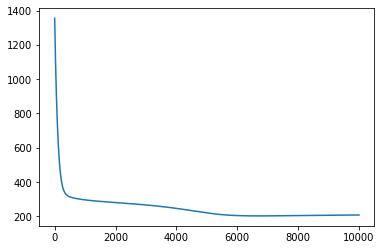

In [127]:
plt.plot(history)

5. Repeat with Momentum

In [132]:
class MLP_Momentum:
  """
  Multilayer Perceptron (ANN with single hidden layer) 
  This output layer of this network is specified for binary classification
  and crossentropy loss. 
  """
  def __init__(self, n_input, n_hidden, alpha=0.25):
    self.n_input = n_input
    self.n_hidden = n_hidden
    self._initialize_weights()
    self.alpha = alpha

  def predict(self, x):
    h = relu(np.dot(x,self.W) + self.b)
    y_hat = sigmoid(np.dot(h, self.v) + self.c)
    return y_hat

  def fit(self, x, y, learning_rate=1e-2, iterations=1000):
    losses = [loss(y, self.predict(x))]

    # gradient descent loop
    prev_velocity = self._grad_f(x, y)
    for i in range(iterations):
      dL_dw, dL_db, dL_dv, dL_dc = self._grad_f(x, y)
      self.W -= (learning_rate * dL_dw + self.alpha *  prev_velocity[0])
      self.b -= (learning_rate * dL_db + self.alpha * prev_velocity[1])
      self.v -= (learning_rate * dL_dv + self.alpha * prev_velocity[2])
      self.c -= (learning_rate * dL_dc + self.alpha * prev_velocity[3])
      losses.append(loss(y, self.predict(x)))
      this_velocity = [self.W, self.b, self.v, self.c]
      prev_velocity = this_velocity
    return losses

  def _grad_f(self, x, y):
    # forward pass
    a = np.dot(x,self.W) + self.b
    h = relu(a)
    y_a = np.dot(h, self.v) + self.c
    y_hat = sigmoid(y_a)

    # backward pass
    dL_dc =  - binary_xent_residual(y, y_hat).dot( y_hat*(1-y_hat) ) / len(y)
    dL_dv = - (binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(h) / len(y)
    dL_db = - ((binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)).T.dot(relu_derivative(a))*self.v) / len(y)
    dL_dw = - x.T.dot(np.expand_dims((binary_xent_residual(y, y_hat) * y_hat*(1-y_hat)),1).dot(np.expand_dims(self.v,1).T)) / len(y)
    return [dL_dw, dL_db, dL_dv, dL_dc]

  def _initialize_weights(self):
    self.W = np.random.randn(self.n_hidden*self.n_input).reshape(((self.n_input,self.n_hidden)))
    self.b = np.random.randn(self.n_hidden)
    self.v = np.random.randn(self.n_hidden)
    self.c = np.random.randn(1)


In [133]:
model2 = MLP_Momentum(n_input=2, n_hidden=4)
history2 = model2.fit(x,y, iterations=100)

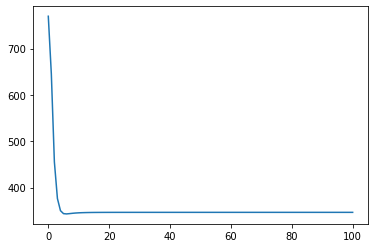

In [134]:
plt.plot(history2)

With momentum the loss went down a lot faster. It took about 500 steps before. Now only 20 steps reduced the loss to the same level.

6. Visualization of decision boundary

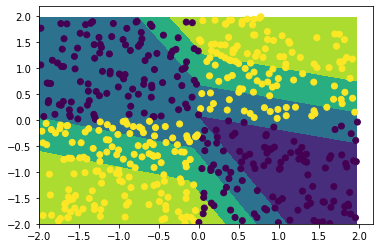

In [128]:
delta = 0.025
x1 = np.arange(-2.0, 2.0, delta)
x2 = np.arange(-2.0, 2.0, delta)
X1, X2 = np.meshgrid(x1, x2)
YHAT = model.predict(np.array((X1.ravel(),X2.ravel())).T).reshape((160,160))
fig, ax = plt.subplots()
CS = ax.contourf(X1, X2, YHAT, levels=[0, .25, .5, .75, 1.0])
plt.scatter(x[:,0],x[:,1],c=y)